In [2]:
import os
import subprocess
import pandas as pd
# pandas provides data structures to work with tabular data
import numpy as np
from sklearn.tree import DecisionTreeClassifier, export_graphviz

### Import the data

In [3]:
# Read the data in csv format
input_file = "Patient-Medical-Data-for-Novel-Coronavirus-COVID-19.csv"

In [4]:
# two primary data structures of pandas, Series (1-dimensional) and DataFrame (2-dimensional)
data = pd.read_csv(input_file, header = 0)

In [5]:
# Vizualize the imported data
data

,Age,Sex,City,AdministrativeDivision,Country,GeoPosition,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,...,TravelHistoryLocation,ReportedMarketExposure,ReportedMarketExposureComment,ChronicDiseaseQ,ChronicDiseases,SequenceAvailable,DischargedQ,DeathQ,DateOfDeath,DateOfDischarge
0,48,"Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough"", ""fatigue"", ""fever"", ""sputum"", ""myalg...",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"{""diabetes"", ""cerebral infarction""}","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
1,"Interval[{15, 88}]","Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""shortness of breath"", ""respiratory symptoms""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]","Missing[""NotAvailable""]"
2,61,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 9}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]"
3,58,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2020, 1, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","{""cough"", ""sputum"", ""fever""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
4,66,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 21}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19462,"Interval[{60, 69}]","Entity[""Gender"", ""Male""]","Missing[""NotAvailable""]","Entity[""AdministrativeDivision"", {""Nevada"", ""U...","Entity[""Country"", ""UnitedStates""]","GeoPosition[{36.2192139, -115.01857}]","Missing[""NotAvailable""]","Missing[""No

### Analyze the data
- get insights of the data

In [6]:
data.shape
# some computations will be performed after deciding which columns are of interest

(19467, 23)

In [7]:
data.columns

Index(['Age', 'Sex', 'City', 'AdministrativeDivision', 'Country',
       'GeoPosition', 'DateOfOnsetSymptoms', 'DateOfAdmissionHospital',
       'DateOfConfirmation', 'Symptoms', 'LivesInWuhan', 'LivesInWuhanComment',
       'TravelHistoryDates', 'TravelHistoryLocation', 'ReportedMarketExposure',
       'ReportedMarketExposureComment', 'ChronicDiseaseQ', 'ChronicDiseases',
       'SequenceAvailable', 'DischargedQ', 'DeathQ', 'DateOfDeath',
       'DateOfDischarge'],
      dtype='object')

In [8]:
data.head() # display first 5 rows

,Age,Sex,City,AdministrativeDivision,Country,GeoPosition,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,...,TravelHistoryLocation,ReportedMarketExposure,ReportedMarketExposureComment,ChronicDiseaseQ,ChronicDiseases,SequenceAvailable,DischargedQ,DeathQ,DateOfDeath,DateOfDischarge
0,48,"Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough"", ""fatigue"", ""fever"", ""sputum"", ""myalg...",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"{""diabetes"", ""cerebral infarction""}","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
1,"Interval[{15, 88}]","Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""shortness of breath"", ""respiratory symptoms""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]","Missing[""NotAvailable""]"
2,61,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 9}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]"
3,58,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2020, 1, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","{""cough"", ""sputum"", ""fever""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
4,66,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"DateObject[{2020, 1, 21}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"


In [9]:
data.dtypes

Age                              object
Sex                              object
City                             object
AdministrativeDivision           object
Country                          object
GeoPosition                      object
DateOfOnsetSymptoms              object
DateOfAdmissionHospital          object
DateOfConfirmation               object
Symptoms                         object
LivesInWuhan                     object
LivesInWuhanComment              object
TravelHistoryDates               object
TravelHistoryLocation            object
ReportedMarketExposure           object
ReportedMarketExposureComment    object
ChronicDiseaseQ                    bool
ChronicDiseases                  object
SequenceAvailable                object
DischargedQ                      object
DeathQ                           object
DateOfDeath                      object
DateOfDischarge                  object
dtype: object

### Prepare the data

- missingData represents 'Missing["NotAvailable"]' from the table

In [10]:
missingData = data['DateOfConfirmation'][0]

- data is a DataFrame in which we combined values from 'DeathQ', 'DischargedQ' and 'DateOfDischarge' colums: if a value in 'DeathQ' is missing, then we check if exists a value in 'DischargedQ' or 'DateOfDischarge' column, and if exists we put the corresponding value in 'DeathQ' column.

In [11]:
data_list = data.values.tolist()
for i in range(len(data_list)):
    if data_list[i][21] == missingData:
        if data_list[i][19]!=missingData:
            data_list[i][20] = 0
        else:
            if data_list[i][22]!=missingData:
                data_list[i][20] = 0
    else:
        data_list[i][20] = 1

data = pd.DataFrame(data_list)
data.columns=['Age','Sex','City','AdministrativeDivision','Country','GeoPosition','DateOfOnsetSymptoms','DateOfAdmissionHospital','DateOfConfirmation','Symptoms','LivesInWuhan','LivesInWuhanComment','TravelHistoryDates','TravelHistoryLocation','ReportedMarketExposure','ReportedMarketExposureComment','ChronicDiseaseQ','ChronicDiseases','SequenceAvailable','DischargedQ','DeathQ','DateOfDeath','DateOfDischarge']
data = data[data['DeathQ']!=missingData]
data

,Age,Sex,City,AdministrativeDivision,Country,GeoPosition,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,...,TravelHistoryLocation,ReportedMarketExposure,ReportedMarketExposureComment,ChronicDiseaseQ,ChronicDiseases,SequenceAvailable,DischargedQ,DeathQ,DateOfDeath,DateOfDischarge
0,48,"Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough"", ""fatigue"", ""fever"", ""sputum"", ""myalg...",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"{""diabetes"", ""cerebral infarction""}","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
1,"Interval[{15, 88}]","Entity[""Gender"", ""Female""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""shortness of breath"", ""respiratory symptoms""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]","Missing[""NotAvailable""]"
2,61,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]",1,"DateObject[{2020, 1, 9}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]"
3,58,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2020, 1, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","{""cough"", ""sputum"", ""fever""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
4,66,"Entity[""Gender"", ""Male""]","Entity[""City"", {""Wuhan"", ""Hubei"", ""China""}]","Entity[""AdministrativeDivision"", {""Hubei"", ""Ch...","Entity[""Country"", ""China""]","GeoPosition[{30.625059999999998, 114.3421}]","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough""}",...,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"DateObject[{2020, 1, 21}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17797,"Interval[{80, 89}]","Entity[""Gender"", ""Female""]","Missing[""NotAvailable""]","Entity[""AdministrativeDivision"", {""Washington""...","Entity[""Country"", ""UnitedStates""]","GeoPosition[{47.4913321, -121.80363999999999}]","Missing[""NotAvailable""]","Missing[""NotA

- In final DataFrame we merge the values from 'City', 'AdministrativeDivision' and 'TravelHistoryLocation' columns in one single 'City' column. Our priority column is 'TravelHistoryLocation', if exists a value here then we take this value else we check the 'City' and 'AdministrativeDivision' columns. We also eliminate the rows where in the 'Sex' column is a missing value.

In [12]:
list = data.values.tolist()
ignore = []
accept = []
for i in range(len(list)):
    str2 = list[i][2]
    if str2 != missingData:
        str2 = str2.split(',')
        val = str2[len(str2)-1]
        val = val[:-2]
        list[i][2] = val.lstrip()
        accept.append(list[i])
    else:
        str2 = list[i][3]
        if str2 != missingData:
            str2 = str2.split(',')
            val = str2[len(str2)-1]
            val = val[:-2]
            list[i][2] = val.lstrip()
            accept.append(list[i])
        else:
            ignore.append(list[i])
final = []
for i in range(len(list)):
    str2 = list[i][13]
    if str2 != missingData:
        index1 = str2.rfind(",")
        index2 = str2.rfind("\"")
        str2 = str2[index1+2:index2+1]
        list[i][13] = str2
        final.append(list[i])
    else:
        if list[i][2] != missingData:
            list[i][13] = list[i][2]
            final.append(list[i])
final = pd.DataFrame(final)
final.columns=['Age','Sex','City','AdministrativeDivision','Country','GeoPosition','DateOfOnsetSymptoms','DateOfAdmissionHospital','DateOfConfirmation','Symptoms','LivesInWuhan','LivesInWuhanComment','TravelHistoryDates','TravelHistoryLocation','ReportedMarketExposure','ReportedMarketExposureComment','ChronicDiseaseQ','ChronicDiseases','SequenceAvailable','DischargedQ','DeathQ','DateOfDeath','DateOfDischarge']
final = final[final['Sex']!= missingData]
print(len(final))

397


- In data2 DataFrame we keep only the relevant columns from final DataFrame.

In [13]:
data2 = final[['Age','Sex','City','DateOfOnsetSymptoms','DateOfAdmissionHospital','DateOfConfirmation','Symptoms','TravelHistoryDates','TravelHistoryLocation','ReportedMarketExposure','ChronicDiseases','DischargedQ','DeathQ','DateOfDischarge']]

In [14]:
data2

,Age,Sex,City,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,TravelHistoryDates,TravelHistoryLocation,ReportedMarketExposure,ChronicDiseases,DischargedQ,DeathQ,DateOfDischarge
0,48,"Entity[""Gender"", ""Female""]","""China""","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough"", ""fatigue"", ""fever"", ""sputum"", ""myalg...","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","{""diabetes"", ""cerebral infarction""}","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
1,"Interval[{15, 88}]","Entity[""Gender"", ""Female""]","""China""","DateObject[{2019, 12, 10}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""shortness of breath"", ""respiratory symptoms""}","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,"Missing[""NotAvailable""]"
2,61,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
3,58,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2020, 1, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","{""cough"", ""sputum"", ""fever""}","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
4,66,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 22}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 31}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","{""cough""}","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,"Interval[{50, 59}]","Entity[""Gender"", ""Male""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 26}, ""Day"", ""Gregorian"", ..."
425,"Interval[{80, 89}]","Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 26}, ""Day"", ""Gregorian"", ..."
426,"Interval[{80, 89}]","Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 1}, ""Day"", ""Gregorian"", -5.]"
427,80,"Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 18}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 19}, ""Day"", ""Gregorian"", ..."


- symptoms DataFrame represents a table where missing values from 'Symptoms' and 'Age' columns are eliminated.

In [15]:
symptoms = data2[data2['Symptoms']!=missingData]

symptoms = symptoms[symptoms['Age']!=missingData]

symptoms.shape

(180, 14)

- ages2 DataFrame represents a table where missing values from 'Symptoms' column are kept and from 'Age' column are eliminated.

In [16]:
ages = data2[data2['Age']!=missingData]
ages2 = ages[ages['Symptoms']==missingData]

ages2[0:]

,Age,Sex,City,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,TravelHistoryDates,TravelHistoryLocation,ReportedMarketExposure,ChronicDiseases,DischargedQ,DeathQ,DateOfDischarge
2,61,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
48,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
49,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
52,44,"Entity[""Gender"", ""Male""]","""Philippines""","DateObject[{2020, 1, 18}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 30}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
56,28,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""Vietnam""",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 1, 28}, ""Day"", ""Gregorian"", ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,"Interval[{50, 59}]","Entity[""Gender"", ""Male""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 26}, ""Day"", ""Gregorian"", ..."
425,"Interval[{80, 89}]","Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 26}, ""Day"", ""Gregorian"", ..."
426,"Interval[{80, 89}]","Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 1}, ""Day"", ""Gregorian"", -5.]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 1}, ""Day"", ""Gregorian"", -5.]"
427,80,"Entity[""Gender"", ""Female""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 18}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""UnitedStates""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 19}, ""Day"", ""Gregorian"", ..."


In [17]:
finalData = pd.concat([ages2,symptoms])
finalData

,Age,Sex,City,DateOfOnsetSymptoms,DateOfAdmissionHospital,DateOfConfirmation,Symptoms,TravelHistoryDates,TravelHistoryLocation,ReportedMarketExposure,ChronicDiseases,DischargedQ,DeathQ,DateOfDischarge
2,61,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
48,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
49,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
52,44,"Entity[""Gender"", ""Male""]","""Philippines""","DateObject[{2020, 1, 18}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 30}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
56,28,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""Vietnam""",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 1, 28}, ""Day"", ""Gregorian"", ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
393,40,"Entity[""Gender"", ""Male""]","""Malaysia""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 1, 25}, ""Day"", ""Gregorian"", ...","{""cough"", ""fever""}","Missing[""NotAvailable""]","""Singapore""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"DateObject[{2020, 2, 8}, ""Day"", ""Gregorian"", -5.]"
397,47,"Entity[""Gender"", ""Male""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","{""asymptomatic"", ""afebrile""}","DateInterval[{{{-Infinity, 1, 1}, {2020, 2, 20...","""Italy""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"Missing[""NotAvailable""]"
398,16,"Entity[""Gender"", ""Male""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 4}, ""Day"", ""Gregorian"", -5.]","{""asymptomatic""}","Missing[""NotAvailable""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"Missing[""NotAvailable""]"
403,69,"Entity[""Gender"", ""Male""]","""Brazil""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 17}, ""Day"", ""Gregorian"", ...","{""fever"", ""cough"", ""myalgias""}","Missing[""NotAvailable""]","""Brazil""","Missing[""NotAvailable""]","{""diabetes"", ""hypertension""}","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 17}, ""Day"", ""Gregorian"", ..."


- In ageIntervalData we changed the interval values from 'Age' column with the average value of this interval.

In [18]:
final2 = finalData.values.tolist()

for i in range(len(finalData)):
    if not final2[i][0].isdigit():
        text = final2[i][0]
        text =text[10:]
        text = text[:-2]
        nums = text.split(',')
        nums = [int(i) for i in nums]
        avg = (nums[0]+nums[1])/2
        final2[i][0] = str(int(avg))
        
ageIntervalData= pd.DataFrame(final2)
ageIntervalData

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,61,"Entity[""Gender"", ""Male""]","""China""","DateObject[{2019, 12, 20}, ""Day"", ""Gregorian"",...","DateObject[{2019, 12, 27}, ""Day"", ""Gregorian"",...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
1,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
2,66,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 17}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]",0,"DateObject[{2020, 2, 12}, ""Day"", ""Gregorian"", ..."
3,44,"Entity[""Gender"", ""Male""]","""Philippines""","DateObject[{2020, 1, 18}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","DateObject[{2020, 1, 30}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]",1,"Missing[""NotAvailable""]"
4,28,"Entity[""Gender"", ""Male""]","""Vietnam""","DateObject[{2020, 1, 20}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 22}, ""Day"", ""Gregorian"", ...","DateObject[{2020, 1, 23}, ""Day"", ""Gregorian"", ...","Missing[""NotAvailable""]","Missing[""NotAvailable""]","""Vietnam""",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]",0,"DateObject[{2020, 1, 28}, ""Day"", ""Gregorian"", ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
382,40,"Entity[""Gender"", ""Male""]","""Malaysia""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 1, 25}, ""Day"", ""Gregorian"", ...","{""cough"", ""fever""}","Missing[""NotAvailable""]","""Singapore""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"DateObject[{2020, 2, 8}, ""Day"", ""Gregorian"", -5.]"
383,47,"Entity[""Gender"", ""Male""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 3}, ""Day"", ""Gregorian"", -5.]","{""asymptomatic"", ""afebrile""}","DateInterval[{{{-Infinity, 1, 1}, {2020, 2, 20...","""Italy""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"Missing[""NotAvailable""]"
384,16,"Entity[""Gender"", ""Male""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 4}, ""Day"", ""Gregorian"", -5.]","{""asymptomatic""}","Missing[""NotAvailable""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True,0,"Missing[""NotAvailable""]"
385,69,"Entity[""Gender"", ""Male""]","""Brazil""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","DateObject[{2020, 3, 17}, ""Day"", ""Gregorian"", ...","{""fever"", ""cough"", ""myalgias""}","Missing[""NotAvailable""]","""Brazil""","Missing[""NotAvailable""]","{""diabetes"", ""hypertension""}","Missing[""NotAvailable""]",0,"DateObject[{2020, 3, 17}, ""Day"", ""Gregorian"", ..."


-   In dateOfConfirmationMonth DataFrame we merge the values from 'DateOfOnsetSymptoms', 'DateOfAdmissionHospital' and 'DateOfConfirmation' columns in one single column which contains the month of confirmation. The highest priority column is 'DateOfConfirmation' column, if exists a value here then we take this value else check the 'DateOfAdmissionHospital' and 'DateOfOnsetSymptoms' columns.

In [19]:
dateofConf = ageIntervalData.values.tolist()
delete=[]
accept = []

for i in range(len(dateofConf)):
    if dateofConf[i][5] == missingData:
        if dateofConf[i][4] == missingData:
            if dateofConf[i][3] != missingData:
                dateofConf[i][5] = dateofConf[i][3]
            else:
                delete.append(i)
        else:
            dateofConf[i][5] = dateofConf[i][4]
            
for i in range(len(dateofConf)):
        
    if i not in delete:
        accept.append(dateofConf[i])
        text = dateofConf[i][5]
        pos1 = text.find('{')
        pos2 = text.find('}')
        text = text[pos1+1:pos2]
        newText = text.split(',')
        dateofConf[i][5] = str(int(newText[1]))

dateOfConfirmationMonth= pd.DataFrame(accept)
dateOfConfirmationMonth = dateOfConfirmationMonth[[0,1,2,5,6,7,8,9,10,11]]
dateOfConfirmationMonth

,0,1,2,5,6,7,8,9,10,11
0,61,"Entity[""Gender"", ""Male""]","""China""",12,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]"
1,66,"Entity[""Gender"", ""Male""]","""Vietnam""",1,"Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]"
2,66,"Entity[""Gender"", ""Male""]","""Vietnam""",1,"Missing[""NotAvailable""]","DateObject[{2020, 1, 13}, ""Day"", ""Gregorian"", ...","""China""",False,"{""hypertension"", ""type 2 diabetes"", ""coronary ...","Missing[""NotAvailable""]"
3,44,"Entity[""Gender"", ""Male""]","""Philippines""",1,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]","Missing[""NotAvailable""]","Missing[""NotAvailable""]"
4,28,"Entity[""Gender"", ""Male""]","""Vietnam""",1,"Missing[""NotAvailable""]","Missing[""NotAvailable""]","""Vietnam""",False,"Missing[""NotAvailable""]","Missing[""NotAvailable""]"
...,...,...,...,...,...,...,...,...,...,...
379,40,"Entity[""Gender"", ""Male""]","""Malaysia""",1,"{""cough"", ""fever""}","Missing[""NotAvailable""]","""Singapore""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True
380,47,"Entity[""Gender"", ""Male""]","""Romania""",3,"{""asymptomatic"", ""afebrile""}","DateInterval[{{{-Infinity, 1, 1}, {2020, 2, 20...","""Italy""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True
381,16,"Entity[""Gender"", ""Male""]","""Romania""",3,"{""asymptomatic""}","Missing[""NotAvailable""]","""Romania""","Missing[""NotAvailable""]","Missing[""NotAvailable""]",True
382,69,"Entity[""Gender"", ""Male""]","""Brazil""",3,"{""fever"", ""cough"", ""myalgias""}","Missing[""NotAvailable""]","""Brazil""","Missing[""NotAvailable""]","{""diabetes"", ""hypertension""}","Missing[""NotAvailable""]"


- In 'genderData' the entity value is split in 'Male' or 'Female'.

In [20]:
date = dateOfConfirmationMonth.values.tolist()

for i in range(len(dateOfConfirmationMonth)):
    if not date[i][1] == missingData:
        text = date[i][1]
        text = text.split(',')
        gender = text[len(text)-1]
        gender = gender[:-1]
        gender = gender.lstrip()
        date[i][1] = gender
        
genderData= pd.DataFrame(date)

-  In 'deathQ' is used a codification for age values and a mapping method for deathQ values. 

In [21]:
confirmation = genderData.values.tolist()

for i in range(len(dateOfConfirmationMonth)):
    if confirmation[i][9]==missingData:
        confirmation[i][9] = str(False)
   
deathQ = pd.DataFrame(confirmation)
deathQ.to_csv("Rez.csv")
deathQ = deathQ[[0,1,3,4,6,8,9]]
deathQ.columns=['Age','Gender','MonthOfConfirmation','Symptoms','TravelLocationHistory','ChronicDiseases','DeathQ']
deathQ['Age'] = np.where(pd.to_numeric(deathQ['Age']).between(0,15,inclusive=True), 0, deathQ['Age'])
deathQ['Age'] = np.where(pd.to_numeric(deathQ['Age']).between(16,30,inclusive=True), 1, deathQ['Age'])
deathQ['Age'] = np.where(pd.to_numeric(deathQ['Age']).between(31,50,inclusive=True), 2, deathQ['Age'])
deathQ['Age'] = np.where(pd.to_numeric(deathQ['Age']).between(51,70,inclusive=True), 3, deathQ['Age'])
deathQ['Age'] = np.where(pd.to_numeric(deathQ['Age']).between(71,120,inclusive=True), 4, deathQ['Age'])
deathQ['DeathQ'] = deathQ['DeathQ'].map({'True':1,'False':0})
deathQ

,Age,Gender,MonthOfConfirmation,Symptoms,TravelLocationHistory,ChronicDiseases,DeathQ
0,3,"""Male""",12,"Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]",0
1,3,"""Male""",1,"Missing[""NotAvailable""]","""China""","{""hypertension"", ""type 2 diabetes"", ""coronary ...",0
2,3,"""Male""",1,"Missing[""NotAvailable""]","""China""","{""hypertension"", ""type 2 diabetes"", ""coronary ...",0
3,2,"""Male""",1,"Missing[""NotAvailable""]","""China""","Missing[""NotAvailable""]",0
4,1,"""Male""",1,"Missing[""NotAvailable""]","""Vietnam""","Missing[""NotAvailable""]",0
...,...,...,...,...,...,...,...
379,2,"""Male""",1,"{""cough"", ""fever""}","""Singapore""","Missing[""NotAvailable""]",1
380,2,"""Male""",3,"{""asymptomatic"", ""afebrile""}","""Italy""","Missing[""NotAvailable""]",1
381,1,"""Male""",3,"{""asymptomatic""}","""Romania""","Missing[""NotAvailable""]",1
382,3,"""Male""",3,"{""fever"", ""cough"", ""myalgias""}","""Brazil""","{""diabetes"", ""hypertension""}",0


- ordinal_encode funcion implements an ordinal encoding and onehot_encode implements one hot encoding on a column.

In [22]:
def ordinal_encode(column):
    ordinal_encoder = OrdinalEncoder()
    ord_column = ordinal_encoder.fit_transform(column)
    return ord_column

def onehot_encode(column):
    cat_encoder = OneHotEncoder()
    onehot_enc = cat_encoder.fit_transform(column)
    return onehot_enc

- We use ordinal encoding for 'Gender' and 'TravelHitoryLocation' columns.

In [23]:
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OneHotEncoder

gender = ordinal_encode(deathQ[['Gender']])
symptoms = onehot_encode(deathQ[['Symptoms']])
chronic = onehot_encode(deathQ[['ChronicDiseases']])
travelhistory = ordinal_encode(deathQ[['TravelLocationHistory']])

deathQ = deathQ.assign(Gender=gender)
deathQ = deathQ.assign(TravelLocationHistory=travelhistory)

- Usage of MinMaxScaler on 'Age', 'Gender', 'MonthOfConfirmation' and 'TravelLocationHistory' columns to scale each value between 0 and 1.

In [24]:
from sklearn import preprocessing
mm_scaler = preprocessing.MinMaxScaler()
age = mm_scaler.fit_transform(deathQ[['Age']])
gen = mm_scaler.fit_transform(deathQ[['Gender']])
month = mm_scaler.fit_transform(deathQ[['MonthOfConfirmation']])
travel = mm_scaler.fit_transform(deathQ[['TravelLocationHistory']])

deathQ = deathQ.assign(Age=age)
deathQ = deathQ.assign(Gender=gen)
deathQ = deathQ.assign(MonthOfConfirmation=month)
deathQ = deathQ.assign(TravelLocationHistory=travel)

deathQ

,Age,Gender,MonthOfConfirmation,Symptoms,TravelLocationHistory,ChronicDiseases,DeathQ
0,0.75,1.0,1.000000,"Missing[""NotAvailable""]",0.12,"Missing[""NotAvailable""]",0
1,0.75,1.0,0.000000,"Missing[""NotAvailable""]",0.12,"{""hypertension"", ""type 2 diabetes"", ""coronary ...",0
2,0.75,1.0,0.000000,"Missing[""NotAvailable""]",0.12,"{""hypertension"", ""type 2 diabetes"", ""coronary ...",0
3,0.50,1.0,0.000000,"Missing[""NotAvailable""]",0.12,"Missing[""NotAvailable""]",0
4,0.25,1.0,0.000000,"Missing[""NotAvailable""]",1.00,"Missing[""NotAvailable""]",0
...,...,...,...,...,...,...,...
379,0.50,1.0,0.000000,"{""cough"", ""fever""}",0.68,"Missing[""NotAvailable""]",1
380,0.50,1.0,0.181818,"{""asymptomatic"", ""afebrile""}",0.40,"Missing[""NotAvailable""]",1
381,0.25,1.0,0.181818,"{""asymptomatic""}",0.64,"Missing[""NotAvailable""]",1
382,0.75,1.0,0.181818,"{""fever"", ""cough"", ""myalgias""}",0.04,"{""diabetes"", ""hypertension""}",0


- encodesWithOnes function implements one hot encoding manually. 'fullUpdatedData' contains the updated values from 'Symptoms' and 'ChronicDiseases' columns after one hot encoding is done. 

In [25]:
def hasNumbers(inputString):
     return any(char.isdigit() for char in inputString)
 
def encodeWithOnes(initialData,j,tip):    
    types=[]
    types.append(tip+'_NoSymptoms')
    mlist = initialData.values.tolist()
    for i in range(len(mlist)):
        _str = mlist[i][j]
        if _str!=missingData:
            _str = _str[1:-1]
            splits = _str.split(',')
            for split in splits:
                split = split.lstrip()
                if (tip+'_'+split) not in types and 'Quantity' not in split and hasNumbers(split) is False:
                    types.append(tip+'_'+split)
    data=[]
    types.sort()
    for i in range(len(mlist)):
        _str = mlist[i][j]
        if _str!=missingData:
            _str = _str[1:-1]
            splits = _str.split(',')
            zeros = [0]*len(types)
            for split in splits:
                split = split.lstrip()
                if 'DegreesCelsius' not in split and'Quantity' not in split and hasNumbers(split) is False:
                     zeros[types.index(tip+'_'+split)] = 1
            data.append(zeros)
        else:
            zeros = [0]*len(types)
            zeros[types.index(tip+'_NoSymptoms')] = 1
            data.append(zeros)
    df = pd.DataFrame(data, columns = types)
    return df
 
symptomsData = encodeWithOnes(deathQ,3,'s')

updatedData = deathQ.join(symptomsData)
updatedData = updatedData.drop('Symptoms',1)
chronicData = encodeWithOnes(updatedData,4,'c')
fullUpdatedData = updatedData.join(chronicData)
fullUpdatedData = fullUpdatedData.drop('ChronicDiseases',1)
fullUpdatedData.shape

(384, 99)

- get_train_val_test functions splits the data in three smaller datasets: train set(60%), cross validation(20%) set and test set(20%).

In [26]:
from sklearn.model_selection import train_test_split
def get_train_val_test():
    train_set_tmp, test_set = train_test_split(fullUpdatedData, test_size=0.2, 
                                               random_state=42,
                                               shuffle=True)
    train_set, cross_validation_set = train_test_split(train_set_tmp, test_size=0.25, 
                                                       random_state=42,
                                                       shuffle=True)
    return train_set,cross_validation_set,test_set

train_set,cross_validation_set,test_set = get_train_val_test()
cross_validation_set.to_csv("cross_validation.csv")
train_set.to_csv("train.csv")
test_set.to_csv("test.csv")
print(len(test_set))
print(len(cross_validation_set))
print(len(train_set))

77
77
230


- plot_learning_curve function displays three type of diagrams: score, scalability and performance for an estimator.
- plot_learning function splits the data in smaller sets and using plot_learning_curve function displays the diagrams for a specific model.

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit

def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None, n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))
    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")
    train_sizes, train_scores, test_scores, fit_times, _ = learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)
    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validation score")
    axes[0].legend(loc="best")
    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")
    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")
    return plt

def plot_learning(model, X, y, title):
    fig, axes = plt.subplots(3, 1, figsize=(10, 15))
    cv = ShuffleSplit(n_splits=10, test_size=0.2, random_state=0)
    plot_learning_curve(model, title, X, y, axes=axes[:], ylim=(0.0, 1.01),cv=cv,n_jobs=4)
    plt.show()

- get_train_val function returns values from training and cross validation sets.

In [28]:
def get_train_val():
    train_set,cross_validation_set,_ = get_train_val_test()
    y_train = train_set['DeathQ'].copy()
    x_train = train_set.drop('DeathQ',1)
    y_val = cross_validation_set['DeathQ'].copy()
    x_val = cross_validation_set.drop('DeathQ',1)
    return y_train,x_train,y_val,x_val

y_train,x_train,y_val,x_val = get_train_val()

### Select a model and train it
#### 1. Decision tree
- non-parametric supervised learning method used for classification
- goal is to create a model that predicts the value of a target variable by learning simple decision rules inferred from the data features
- cost of using the tree is logarithmic in the number of data points used to train the tree
- cons: decision tree learners create biased trees if some classes dominate

In [29]:
from sklearn import tree
clf = tree.DecisionTreeClassifier(criterion='entropy') # measure information gain
clf.fit(x_train,y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

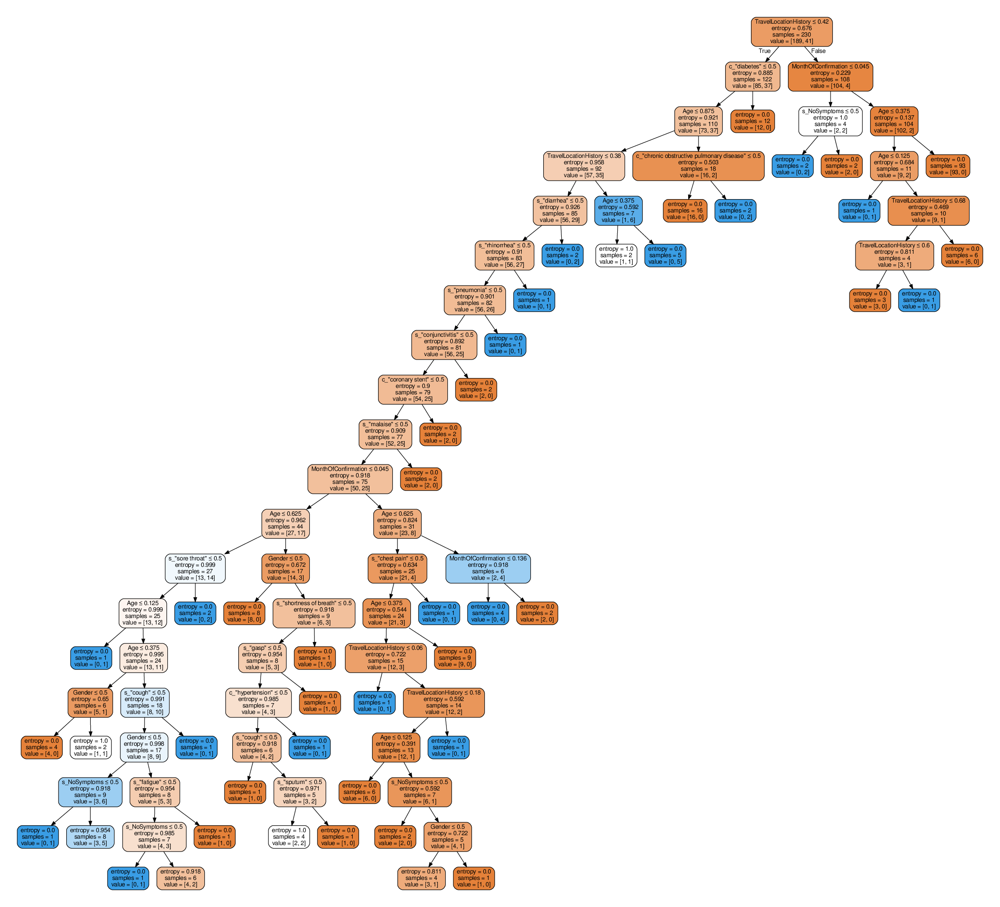

In [42]:
import graphviz
from wand.image import Image as WImage
# vizualize the tree resulted from training the model
features = x_train.columns
dot_data = tree.export_graphviz(clf, out_file=None,  feature_names=features,  filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data)
graph.render('covid')

img = WImage(filename='covid.pdf')
img

The model considers the features "Travel history locations", "Diabetes", and "Month of confirmation" as the most important features on the top of the tree as these features splits the train set such that the information gain is highest at that level.

In [30]:
from sklearn.metrics import classification_report, confusion_matrix

def print_confusion_matrix(model, x_val):
    y_pred_val = model.predict(x_val)
    print(confusion_matrix(y_val, y_pred_val))
    print(classification_report(y_val, y_pred_val))
    
print_confusion_matrix(clf, x_val)

[[59  5]
 [ 2 11]]
              precision    recall  f1-score   support

           0       0.97      0.92      0.94        64
           1       0.69      0.85      0.76        13

    accuracy                           0.91        77
   macro avg       0.83      0.88      0.85        77
weighted avg       0.92      0.91      0.91        77



#### 2. Stochastic Gradient Descent
- This estimator implements regularized linear models with stochastic gradient descent (SGD) learning. The loss parameter refers to the loss function, which is 'log' in our case. The log loss gives a logistic regression, a probabilistic classifier. 'l2' is the standard regularizer for linear models. The maximum number of iteration is 1000 which means that after 1000 iterations the train will stop.
- after that the fit method is applied, which does the training on the model. The score method returns the mean accuracy on the given test data 

In [ ]:
from sklearn.linear_model import SGDClassifier

sgd_clf = SGDClassifier(loss="log", penalty="l2", max_iter=1000)
sgd_clf.fit(x_train, y_train)

- The mean accuracy looks very good on train set.

In [45]:
sgd_clf.score(x_val,y_val)

0.8571428571428571

#### 3. Support Vector Machine - Linear
- effective in cases where number of dimensions is comparable to the number of samples
- uses a subset of training points in the decision function (called support vectors)
- kernel functions can be specified for the decision function
- linearSVC is a faster implementation of Support Vector Classification for the case of a linear kernel

In [46]:
from sklearn import svm
lin_clf = svm.LinearSVC()
lin_clf.fit(x_train, y_train)
lin_clf.score(x_val,y_val)

0.8571428571428571

#### 4. Support Vector Machine - Polynomial

- SVC refers to the Support Vector Classification. 'C' represents the regularization parameter, 'poly' specifies the kernel type to be used in the algorithm and 3 is the degree of the polynomial kernel function('poly').
- Score function repsents the main accuracy, which is a little bit bigger then the accuracy we got on SVC Linear classification.

In [ ]:
C = 1.0
poly_svc = svm.SVC(kernel='poly', degree=3, C=C).fit(x_train, y_train)
poly_svc.score(x_val,y_val)

#### 5.Neural network - Multi-layer perceptron
- express fairly complex decision functions
- given a set of features, and a target, it can learn a non-linear function approximator for either classification or regression

In [48]:
from sklearn.neural_network import MLPClassifier
nn_clf = MLPClassifier(solver='adam', # choose from lbfgs, sgd or adam
                       alpha=0.001, # L2 penalty parameter
                       activation='relu', # for the hidden layer
                       #tol=1e-16,
                       batch_size=4, # lbfgs will not use minibatch
                       hidden_layer_sizes=(2), # number of neurons/ ith layer
                       # for example (3,4) will define 2 layers with 3 neurons/fist layers and 4 
                       # on the other layer
                       max_iter=1000, # stop algorithm at max_iter iteration even if not converged
                       random_state=1, # random number generation for weights and bias
                       verbose=True) # display loss/ each iteration
nn_clf.fit(x_train,y_train)

Iteration 1, loss = 1.29766232
Iteration 2, loss = 1.25003514
Iteration 3, loss = 1.21468947
Iteration 4, loss = 1.18287905
Iteration 5, loss = 1.15246700
Iteration 6, loss = 1.12296260
Iteration 7, loss = 1.09441061
Iteration 8, loss = 1.06671018
Iteration 9, loss = 1.03972368
Iteration 10, loss = 1.01361849
Iteration 11, loss = 0.98857793
Iteration 12, loss = 0.96458660
Iteration 13, loss = 0.94121385
Iteration 14, loss = 0.91873443
Iteration 15, loss = 0.89689341
Iteration 16, loss = 0.87590010
Iteration 17, loss = 0.85581528
Iteration 18, loss = 0.83649965
Iteration 19, loss = 0.81792297
Iteration 20, loss = 0.80025306
Iteration 21, loss = 0.78299510
Iteration 22, loss = 0.76658923
Iteration 23, loss = 0.75074701
Iteration 24, loss = 0.73564962
Iteration 25, loss = 0.72130489
Iteration 26, loss = 0.70756994
Iteration 27, loss = 0.69438810
Iteration 28, loss = 0.68188517
Iteration 29, loss = 0.66997339
Iteration 30, loss = 0.65846435
Iteration 31, loss = 0.64748070
Iteration 32, los

MLPClassifier(activation='relu', alpha=0.001, batch_size=4, beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=2, learning_rate='constant',
              learning_rate_init=0.001, max_fun=15000, max_iter=1000,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=1, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=True,
              warm_start=False)

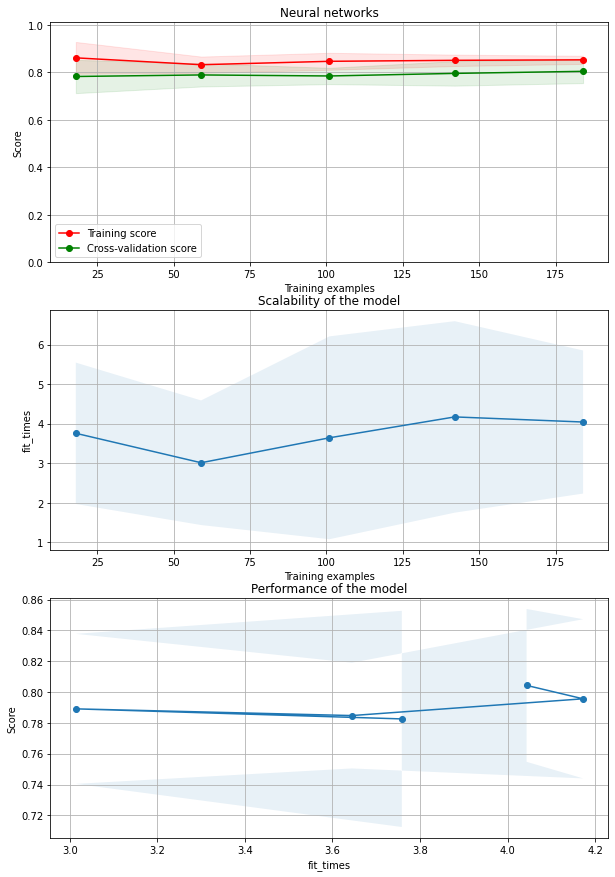

In [49]:
estimator = nn_clf
plot_learning(estimator, x_train, y_train, "Neural networks")

- in the first plot we can see the learning curves for train and cross validation sets; they are close to each other, and both are above 0.8 after a certain number of iterations on different set sizes resulting in no overfit 
- the plot in the second row show the times required by the models to train with various sizes of training dataset. 
- the plot in the third row show how much time was required to train the models for each training sizes; the evolution of performance in time given each training set size

#### 6. Naive Bayes
- GaussianNB (Gaussian Naive Bayes) can perform online updates to model parameters using incremental fit on a batch of samples. 
- plot_learning function generates some diagrams with the score, scalability and the performance of the model. This method doesn't work very well, we can see on the score diagram that the model has score of approximate 0,5.

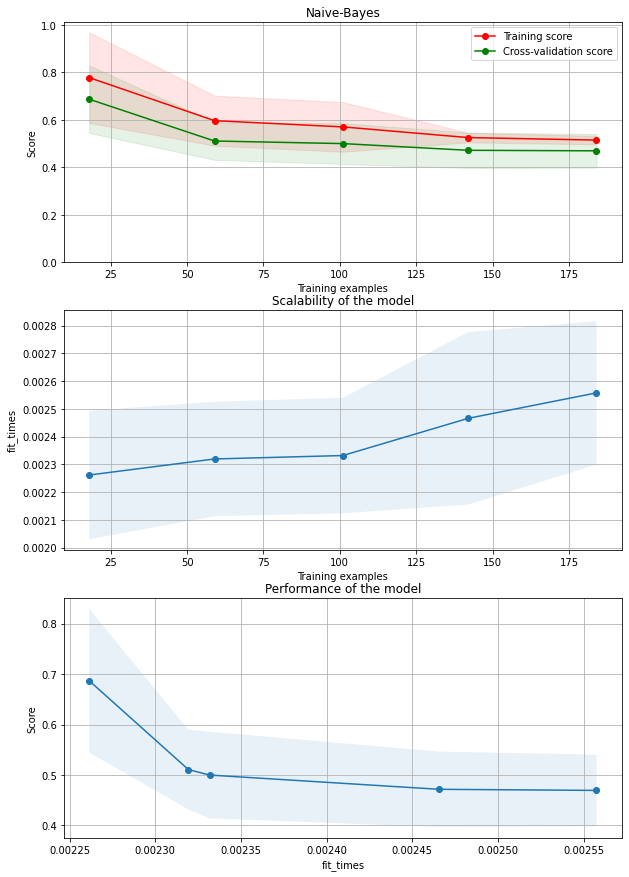

In [50]:
estimator = GaussianNB()
plot_learning(estimator, x_train, y_train, "Naive-Bayes")

#### 7. Random Forest Classifier
- a classic machine learning ensemble method
- combine less complex tree (DT) results (classification results) for the final output (bagging)

[1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0
 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1
 0 0 1]


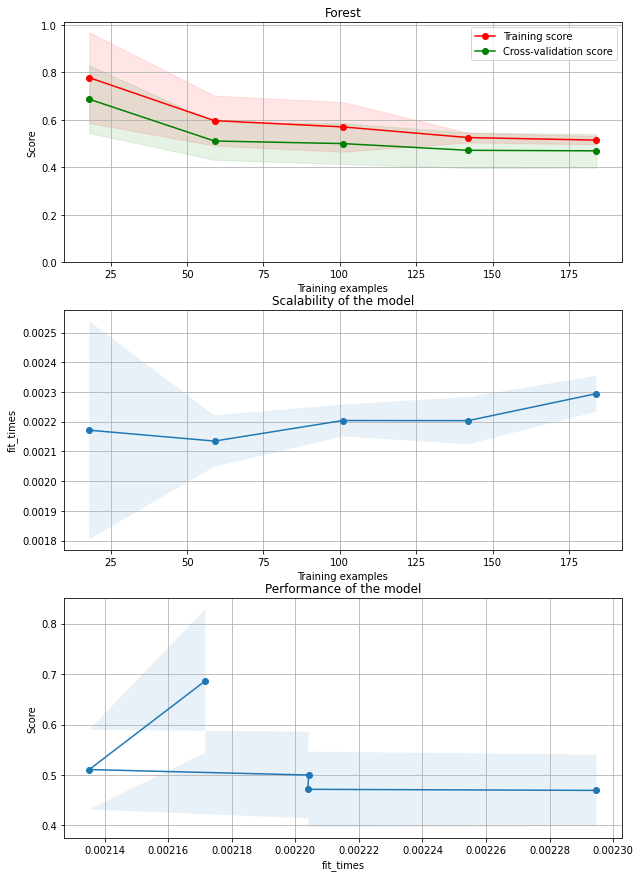

In [51]:
from sklearn.ensemble import RandomForestClassifier

forest = RandomForestClassifier(n_estimators=100) # the number of trees in the forest.
forest.fit(x_train,y_train)
y_pred = forest.predict(x_val)
print(y_pred)
plot_learning(estimator, x_train, y_train, "Forest")

### Fine tune the model

As seen above fitting a polynomial functions performed the best resulting in a training accuracy of 88%. An interesting result was obtained by using neural networks as the learning algorithm, so these two will be further taken for further improvements.

##### Try to improve the polynomial degree
With degree 3 the accuracy was 0.87, if we increase the degree to 7 and adding a small amount of regularization we obtain:

In [52]:
C = 0.7
poly_svc = svm.SVC(kernel='poly', degree=7, C=C).fit(x_train, y_train)
poly_svc.score(x_val,y_val)

0.8831168831168831

No regularization but a less complex model :

In [53]:
C = 1
poly_svc = svm.SVC(kernel='poly', degree=4, C=C).fit(x_train, y_train)
poly_svc.score(x_val,y_val)

0.8961038961038961

Trying to improve the neural network:

In [54]:
from sklearn.neural_network import MLPClassifier
nn_clf = MLPClassifier(solver='lbfgs', 
                       alpha=0.001,
                       learning_rate_init=0.0001,
                       #learning_rate = 'adaptive',
                       activation='tanh',
                       #tol=1e-16,
                       batch_size=4,
                       hidden_layer_sizes=(3,3,3), 
                       max_iter=100000,
                       random_state=1, 
                       verbose=True)
y_train,x_train,y_val,x_val = get_train_val()
nn_clf.fit(x_train,y_train)
y_pred = nn_clf.predict(x_val)

The conclusion is that lbfgs with 3 hidden layers with 3 neurons/ each layer presented the lowest number of misclassifications "8 out of 77":

In [55]:
print("Predicted: ")
print(y_pred)
print("Actual: ")
print(y_val.values)
diff = []
for i in range(len(y_pred)):
    diff.append(y_pred[i]-y_val.values[i])
# count where there is a 1 or -1
print(str(len([i for i in diff if abs(i)==1]))+" out of "+str(len(y_pred)))

Predicted: 
[1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1
 0 0 1]
Actual: 
[1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1
 0 0 1]
8 out of 77


In [56]:
print_confusion_matrix(nn_clf,x_val)

[[61  3]
 [ 5  8]]
              precision    recall  f1-score   support

           0       0.92      0.95      0.94        64
           1       0.73      0.62      0.67        13

    accuracy                           0.90        77
   macro avg       0.83      0.78      0.80        77
weighted avg       0.89      0.90      0.89        77



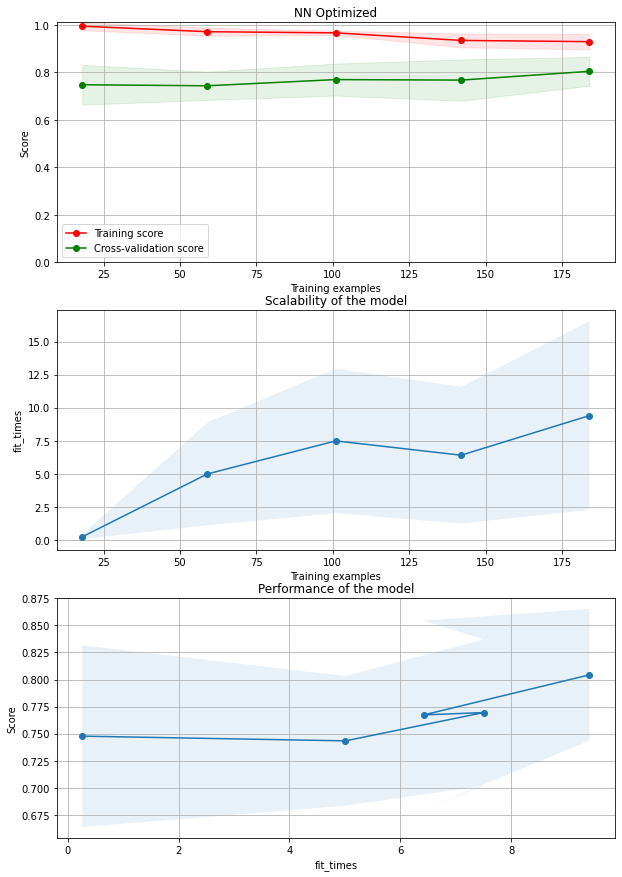

In [57]:
plot_learning(nn_clf, x_train, y_train, "NN Optimized")
#spui ca nu are dar de fapt are recall pentru 1

There is a method of passing hyperparameter domains from which an algorithm such as Grid Search will
try different combinations of them and train different classifiers on the train set and compare them on cross-validation set in order to decide which model fits the best the data. This an efficient 
method to find the best hyperparameters, but it costs time.

In [58]:
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPClassifier
nn_clf2 = MLPClassifier(solver='lbfgs', 
                       alpha=0.001,
                       learning_rate_init=0.0001,
                       #learning_rate = 'adaptive',
                       activation='tanh',
                       #tol=1e-16,
                       batch_size=4,
                       hidden_layer_sizes=(3,3,3), 
                       max_iter=100000,
                       random_state=1, 
                       verbose=True)
y_train2,x_train2,y_val2,x_val2 = get_train_val()
param_grid = [
    {'solver': ['lbfgs'], 'alpha':[0.0001,0.001,0.01], 'activation':['tanh','relu','logistic'],'hidden_layer_sizes':[(3,3,3),(4,4,4),(8,8)]},
    {'solver': ['sgd'], 'alpha':[0.0001,0.001,0.01],'learning_rate':['adaptive'], 'activation':['tanh','relu','logistic'],'batch_size':[4,8],'hidden_layer_sizes':[(3,3,3),(8,8,4),(50,50),(70)]},
    {'solver': ['adam'], 'alpha':[0.0001,0.001,0.01], 'activation':['tanh','relu','logistic'],'batch_size':[4,8,12],'hidden_layer_sizes':[(3,3),(3,3,3),(3),(4,4),(8,8,4),(16,8),(70)]}
  ]

grid_search = GridSearchCV(nn_clf2, param_grid, cv=5,
                           scoring='accuracy', return_train_score=True)
grid_search.fit(x_train2, y_train2)
print(grid_search.best_score_)
print(grid_search.best_params_)

/root/anaconda3/envs/pomegranate/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 1, loss = 0.62647386
Iteration 2, loss = 0.60734679
Iteration 3, loss = 0.59047595
Iteration 4, loss = 0.57562660
Iteration 5, loss = 0.56292659
Iteration 6, loss = 0.55241557
Iteration 7, loss = 0.54279717
Iteration 8, loss = 0.53480819
Iteration 9, loss = 0.52766460
Iteration 10, loss = 0.52151765
Iteration 11, loss = 0.51633371
Iteration 12, loss = 0.51144229
Iteration 13, loss = 0.50751731
Iteration 14, loss = 0.50409813
Iteration 15, loss = 0.50055499
Iteration 16, loss = 0.49783227
Iteration 17, loss = 0.49531915
Iteration 18, loss = 0.49308459
Iteration 19, loss = 0.49101089
Iteration 20, loss = 0.48924124
Iteration 21, loss = 0.48760240
Iteration 22, loss = 0.48614310
Iteration 23, loss = 0.48482260
Iteration 24, loss = 0.48357793
Iteration 25, loss = 0.48251520
Iteration 26, loss = 0.48151594
Iteration 27, loss = 0.48058878
Iteration 28, loss = 0.47975256
Iteration 29, loss = 0.47903805
Iteration 30, loss = 0.47836891
Iteration 31, loss = 0.47763453
Iteration 32, los

### Testing the data
- In this section we test the neural network MLPClassifier on the test set of the data and we computed the confusion matrix to evaluate the accuracy of the classification. The mean accuracy is 0.74 on the test set with 77 values.

In [59]:
_,_,test_set = get_train_val_test() # get train,cross validation and test sets
y_test = test_set['DeathQ'].copy()
x_test = test_set.drop('DeathQ',1)
print_confusion_matrix(nn_clf,x_test) # above defined method

[[55  9]
 [11  2]]
              precision    recall  f1-score   support

           0       0.83      0.86      0.85        64
           1       0.18      0.15      0.17        13

    accuracy                           0.74        77
   macro avg       0.51      0.51      0.51        77
weighted avg       0.72      0.74      0.73        77



   While it sounds encouraging, the recall for the positive class is low. This can be interpreted as: "among all the persons which will actually not survive because of being infected with COVID what is the fraction the system detected correclty as not surviving?". If a person has a high chance to not survive because of COVID infestation it should be detected with higher accuracy in order to get medical attention. If the system detected that the person will die because of this, but in reality nothing of this tragic happens the worst case to happen will be just a shock for that person, while in the first case medicamentation is crucial. 
    This can be improved by choosing to train the model given the hyperparameters from the grid search algorithm performed above:

In [63]:
nn_clf3 = MLPClassifier(solver='lbfgs', 
                       alpha=0.01,
                       activation='logistic',
                       hidden_layer_sizes=(4,4,4), 
                       random_state=1, 
                       verbose=True)
nn_clf3.fit(x_train,y_train)
print_confusion_matrix(nn_clf3,x_val)

[[62  2]
 [ 9  4]]
              precision    recall  f1-score   support

           0       0.87      0.97      0.92        64
           1       0.67      0.31      0.42        13

    accuracy                           0.86        77
   macro avg       0.77      0.64      0.67        77
weighted avg       0.84      0.86      0.83        77



/root/anaconda3/envs/pomegranate/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


0.8701298701298701

### Final result

While on cross validation set the score was the highest using DTL, the accuracy on the test set is reduced significantly in comparison with the neural network trained using the hyperparameters given by Grid Search:

In [31]:
_,_,test_set = get_train_val_test() # get train,cross validation and test sets
y_test = test_set['DeathQ'].copy()
x_test = test_set.drop('DeathQ',1)
print_confusion_matrix(clf,x_test) # above defined method

[[55  9]
 [10  3]]
              precision    recall  f1-score   support

           0       0.85      0.86      0.85        64
           1       0.25      0.23      0.24        13

    accuracy                           0.75        77
   macro avg       0.55      0.55      0.55        77
weighted avg       0.75      0.75      0.75        77



In [64]:
from sklearn.metrics import accuracy_score
y_pred_test = nn_clf3.predict(x_test)
accuracy_score(y_test, y_pred_test,normalize=True)

0.8701298701298701

To draw a conclusion the system performs reasonably well on the test set reaching a mean accuracy of 0.87. While in most cases this a good result, we should keep in mind that the model was trained with a small number of training examples and its ability to generalize is limited to this number.  